In [1]:
# !pip install gensim
# !pip install pyLDAvis
# !pip install spacy
# !pip install wordcloud
# !pip install nltk
# !pip install scikit-learn
# !pip install scipy

# !python -m spacy download en_core_web_sm

In [2]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from collections import Counter
import gensim
import numpy as np
import spacy
import math
from scipy.sparse import csr_matrix
from sklearn.preprocessing import normalize

from gensim.models import CoherenceModel, LdaModel, LsiModel, HdpModel
from gensim.models.wrappers import LdaMallet
from gensim.corpora import Dictionary
import pyLDAvis.gensim

import nltk
nltk.download('stopwords')
nltk.download('vader_lexicon')
nltk.download('punkt')
from nltk.corpus import stopwords
from nltk.sentiment.vader import SentimentIntensityAnalyzer

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction import text

import os, re, operator, warnings
warnings.filterwarnings('ignore')
%matplotlib inline

C:\Users\LENOVO\Anaconda3\lib\site-packages\nltk\decorators.py:70: DeprecationWarning: `formatargspec` is deprecated since Python 3.5. Use `signature` and the `Signature` object directly
  formatvalue=lambda value: "")[1:-1]


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\LENOVO\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\LENOVO\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\LENOVO\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


C:\Users\LENOVO\Anaconda3\lib\site-packages\nltk\twitter\__init__.py:20: UserWarning: The twython library has not been installed. Some functionality from the twitter package will not be available.
  warnings.warn("The twython library has not been installed. "


In [3]:
def clean(text):
    return str(''.join([i if ord(i) < 128 else ' ' for i in text]))

test_data_dir = '{}'.format(os.sep).join([gensim.__path__[0], 'test', 'test_data'])
lee_train_file = test_data_dir + os.sep + 'lee_background.cor'

In [4]:
text = open(lee_train_file).read()
nlp = spacy.load("en_core_web_sm")
stop_words = stopwords.words('english')

In [5]:
for stopword in stop_words:
    lexeme = nlp.vocab[stopword]
    lexeme.is_stop = True

In [6]:
doc = nlp(clean(text))

In [7]:
doc

Hundreds of people have been forced to vacate their homes in the Southern Highlands of New South Wales as strong winds today pushed a huge bushfire towards the town of Hill Top. A new blaze near Goulburn, south-west of Sydney, has forced the closure of the Hume Highway. At about 4:00pm AEDT, a marked deterioration in the weather as a storm cell moved east across the Blue Mountains forced authorities to make a decision to evacuate people from homes in outlying streets at Hill Top in the New South Wales southern highlands. An estimated 500 residents have left their homes for nearby Mittagong. The New South Wales Rural Fire Service says the weather conditions which caused the fire to burn in a finger formation have now eased and about 60 fire units in and around Hill Top are optimistic of defending all properties. As more than 100 blazes burn on New Year's Eve in New South Wales, fire crews have been called to new fire at Gunning, south of Goulburn. While few details are available at this

In [9]:
texts, article =[],[]
for w in doc:
    if w.text != "\n" and not w.is_stop and not w.is_punct and not w.like_num:
        article.append(w.lemma_)
    if w.text == "\n":
        texts.append(article)
        article = []
        

In [10]:
transformed_texts = [" ".join(i) for i in texts]

In [11]:
transformed_texts_1 = [i.lower() for i in transformed_texts]

In [12]:
transformed_texts_2 = [re.sub(r'\w*\d\w*',"",i).strip() for i in transformed_texts_1] #remove number
transformed_texts_2

['hundred people force vacate home southern highlands new south wales strong wind today push huge bushfire town hill new blaze near goulburn south west sydney force closure hume highway : aedt marked deterioration weather storm cell move east blue mountains force authority decision evacuate people home outlying street hill new south wales southern highland estimate resident leave home nearby mittagong new south wales rural fire service say weather condition cause fire burn finger formation ease fire unit hill optimistic defend property blaze burn new year eve new south wales fire crew call new fire gunning south goulburn detail available stage fire authority say close hume highway direction new fire sydney west long threaten property cranebrook area rain fall part illawarra sydney hunter valley north coast bureau meteorology claire richards say rain little ease fire burn state fall isolated area generally fall millimetre say place significant millimetre relief far rain concern fact pro

In [13]:
def IDF(corpus, unique_words):
    idf_dict={}
    N=len(corpus)
    for i in unique_words:
        count=0
        for sen in corpus:
            if i in sen.split():
                count=count+1
            idf_dict[i]=(math.log((1+N)/(count+1)))+1 
    return idf_dict

def fit(whole_data):
    unique_words = set()
    if isinstance(whole_data, (list,)):
        for x in whole_data:
            for y in x.split():
                if len(y)<2:
                    continue
                unique_words.add(y)
        unique_words = sorted(list(unique_words))
        vocab = {j:i for i,j in enumerate(unique_words)}
        Idf_values_of_all_unique_words=IDF(whole_data,unique_words)
    return vocab, Idf_values_of_all_unique_words

def transform(dataset,vocabulary,idf_values):
    vocab = {}
    sparse_matrix= csr_matrix( (len(dataset), len(vocabulary)), dtype=np.float64)
    for row  in range(0,len(dataset)):
        number_of_words_in_sentence=Counter(dataset[row].split())
        for word in dataset[row].split():
            if word in  list(vocabulary.keys()):
                tf_idf_value=(number_of_words_in_sentence[word]/len(dataset[row].split()))*(idf_values[word])
                sparse_matrix[row,vocabulary[word]]=tf_idf_value
                vocab[word] = tf_idf_value
    return vocab

In [14]:
vocabulary , idf_of_vocabulary = fit(transformed_texts_2)

In [15]:
vocabulary

{'aamer': 0,
 'aarage': 1,
 'abandon': 2,
 'abate': 3,
 'abbott': 4,
 'abc': 5,
 'abdel': 6,
 'abdoman': 7,
 'abdominal': 8,
 'abduct': 9,
 'abduction': 10,
 'abdul': 11,
 'abdullah': 12,
 'abegglen': 13,
 'abide': 14,
 'ability': 15,
 'able': 16,
 'abloy': 17,
 'ablution': 18,
 'ably': 19,
 'aboard': 20,
 'aboriginal': 21,
 'abortion': 22,
 'abroad': 23,
 'abruptly': 24,
 'abscond': 25,
 'absolutely': 26,
 'abstain': 27,
 'abu': 28,
 'abuse': 29,
 'abusive': 30,
 'aca': 31,
 'academic': 32,
 'accc': 33,
 'accelerate': 34,
 'accept': 35,
 'acceptable': 36,
 'access': 37,
 'accident': 38,
 'accolade': 39,
 'accommodation': 40,
 'accompany': 41,
 'accomplishment': 42,
 'accord': 43,
 'account': 44,
 'accountable': 45,
 'accountancy': 46,
 'accounting': 47,
 'accrue': 48,
 'accumulate': 49,
 'accuracy': 50,
 'accurate': 51,
 'accusation': 52,
 'accuse': 53,
 'acdt': 54,
 'achieve': 55,
 'achievement': 56,
 'acknowledge': 57,
 'acquisition': 58,
 'acquit': 59,
 'act': 60,
 'action': 61,
 '

In [16]:
idf_of_vocabulary

{'aamer': 6.0106352940962555,
 'aarage': 6.0106352940962555,
 'abandon': 5.0943445622221,
 'abate': 5.605170185988092,
 'abbott': 6.0106352940962555,
 'abc': 5.605170185988092,
 'abdel': 5.605170185988092,
 'abdoman': 6.0106352940962555,
 'abdominal': 6.0106352940962555,
 'abduct': 6.0106352940962555,
 'abduction': 6.0106352940962555,
 'abdul': 5.0943445622221,
 'abdullah': 5.605170185988092,
 'abegglen': 5.31748811353631,
 'abide': 6.0106352940962555,
 'ability': 4.912023005428146,
 'able': 3.870569130599985,
 'abloy': 5.31748811353631,
 'ablution': 6.0106352940962555,
 'ably': 6.0106352940962555,
 'aboard': 4.7578723256008875,
 'aboriginal': 5.31748811353631,
 'abortion': 6.0106352940962555,
 'abroad': 5.605170185988092,
 'abruptly': 6.0106352940962555,
 'abscond': 5.605170185988092,
 'absolutely': 4.506557897319982,
 'abstain': 6.0106352940962555,
 'abu': 4.912023005428146,
 'abuse': 4.506557897319982,
 'abusive': 5.605170185988092,
 'aca': 6.0106352940962555,
 'academic': 6.0106352

In [17]:
sorted_idf = dict(sorted(idf_of_vocabulary.items(),key=operator.itemgetter(1),reverse=True)) 

In [18]:
sorted_idf

{'aamer': 6.0106352940962555,
 'aarage': 6.0106352940962555,
 'abbott': 6.0106352940962555,
 'abdoman': 6.0106352940962555,
 'abdominal': 6.0106352940962555,
 'abduct': 6.0106352940962555,
 'abduction': 6.0106352940962555,
 'abide': 6.0106352940962555,
 'ablution': 6.0106352940962555,
 'ably': 6.0106352940962555,
 'abortion': 6.0106352940962555,
 'abruptly': 6.0106352940962555,
 'abstain': 6.0106352940962555,
 'aca': 6.0106352940962555,
 'academic': 6.0106352940962555,
 'accc': 6.0106352940962555,
 'accelerate': 6.0106352940962555,
 'acceptable': 6.0106352940962555,
 'accolade': 6.0106352940962555,
 'accommodation': 6.0106352940962555,
 'accountable': 6.0106352940962555,
 'accounting': 6.0106352940962555,
 'accrue': 6.0106352940962555,
 'accuracy': 6.0106352940962555,
 'accusation': 6.0106352940962555,
 'achievement': 6.0106352940962555,
 'acquisition': 6.0106352940962555,
 'activist': 6.0106352940962555,
 'actress': 6.0106352940962555,
 'adams': 6.0106352940962555,
 'adhere': 6.010635

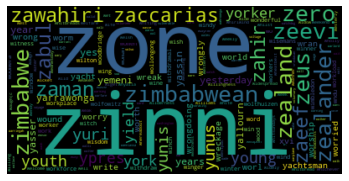

In [19]:
wordcloud = WordCloud().generate_from_frequencies(vocabulary)
plt.imshow(wordcloud,interpolation="bilinear")
plt.axis('off')
plt.show()

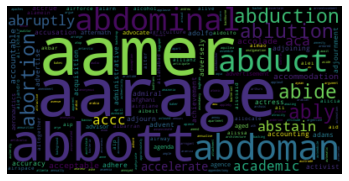

In [20]:
wordcloud = WordCloud().generate_from_frequencies(idf_of_vocabulary)
plt.imshow(wordcloud,interpolation="bilinear")
plt.axis('off')
plt.show() # rare word

In [21]:
stop_words.extend(["aamer"])
stopwords_dict = Counter(stop_words)
transformed_texts_3 = [' '.join([word for word in i.split() if word not in stopwords_dict]) for i in transformed_texts_2]

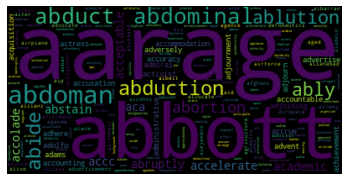

In [22]:
vocabulary , idf_of_vocabulary = fit(transformed_texts_3)
wordcloud = WordCloud().generate_from_frequencies(idf_of_vocabulary)
plt.imshow(wordcloud,interpolation="bilinear")
plt.axis('off')
plt.show() # rare word 

In [23]:
#idf show just rare word not important word
#tf idf show importnat word

In [24]:
final_output = transform(transformed_texts_3,vocabulary,idf_of_vocabulary)

In [25]:
final_output

{'hundred': 0.01833370536903864,
 'people': 0.03608595756191217,
 'force': 0.08338665510199662,
 'vacate': 0.03780273769871859,
 'home': 0.03748861398505311,
 'southern': 0.06345195296065549,
 'highlands': 0.03780273769871859,
 'new': 0.037475219440501965,
 'south': 0.04025061037060397,
 'wales': 0.05414073922941059,
 'strong': 0.19352845652999928,
 'wind': 0.02638385068735852,
 'today': 0.044512627639838674,
 'push': 0.01849736373190546,
 'huge': 0.011606164964576362,
 'bushfire': 0.03127934184433124,
 'town': 0.01585158771135653,
 'hill': 0.3515729854056834,
 'blaze': 0.07434175508751387,
 'near': 0.05257827726540527,
 'goulburn': 0.07560547539743719,
 'west': 0.01293256013382952,
 'sydney': 0.03484313994238426,
 'closure': 0.03224268710267152,
 'hume': 0.15789211791515753,
 'highway': 0.0779686191337801,
 'aedt': 0.024486296054463508,
 'marked': 0.02480163799109775,
 'deterioration': 0.03780273769871859,
 'weather': 0.06340635084542612,
 'storm': 0.16226445480262314,
 'cell': 0.2311

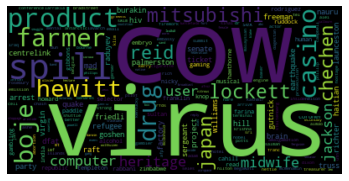

In [26]:
wordcloud = WordCloud().generate_from_frequencies(final_output)
plt.imshow(wordcloud,interpolation="bilinear")
plt.axis('off')
plt.show() # importnat word tf idf

## tfidf with sci kit lean

In [27]:
tfidf = TfidfVectorizer(sublinear_tf=True, min_df=5 , norm='l2', encoding='latin-1',
                        ngram_range=(1,1),stop_words=stop_words)
features = tfidf.fit_transform(transformed_texts_3)

d = tfidf.vocabulary_

In [28]:
wordcloud = WordCloud(background_color="white",max_words=2000,width=1024,height=720).generate_from_frequencies(d)
plt.figure(dpi=1000,figsize=(20,8))
plt.title("WordClound")
plt.imshow(wordcloud,interpolation="bilinear")
plt.axis('off')
plt.show() # importnat word tf idf

## sentiment analysis

In [29]:
sid = SentimentIntensityAnalyzer()
for i in range(len(transformed_texts_3)):
    print(transformed_texts_3[i] + ": ")
    scores = sid.polarity_scores(transformed_texts_3[i])
    print(scores)

hundred people force vacate home southern highlands new south wales strong wind today push huge bushfire town hill new blaze near goulburn south west sydney force closure hume highway : aedt marked deterioration weather storm cell move east blue mountains force authority decision evacuate people home outlying street hill new south wales southern highland estimate resident leave home nearby mittagong new south wales rural fire service say weather condition cause fire burn finger formation ease fire unit hill optimistic defend property blaze burn new year eve new south wales fire crew call new fire gunning south goulburn detail available stage fire authority say close hume highway direction new fire sydney west long threaten property cranebrook area rain fall part illawarra sydney hunter valley north coast bureau meteorology claire richards say rain little ease fire burn state fall isolated area generally fall millimetre say place significant millimetre relief far rain concern fact proba

{'neg': 0.252, 'neu': 0.629, 'pos': 0.119, 'compound': -0.9612}
woomera detention centre outback south australia experience quiet night week sunday government decision freeze processing visa application work outside centre appear major incident facility day yesterday unrest overnight : acdt morning minibus load security officer leave centre extra police resource bring town recent day stand immigration department claim damage bill arson attack vandalism centre past month reach $ spokeswoman reject claim detainee woomera centre relocate port augusta el alamein centre month say room people woomera: 
{'neg': 0.154, 'neu': 0.789, 'pos': 0.057, 'compound': -0.8402}
private business sector comply national privacy law today force implement new code handling personal information government credit sector oblige protect private datum time rule apply private sector new law consent knowledge data use accuracy security health datum purpose take example treatment federal privacy commissioner malcolm 

{'neg': 0.15, 'neu': 0.709, 'pos': 0.141, 'compound': -0.9118}
helicopter land near tora bora mountain eastern afghanistan start raid al qaeda fighter afp journalist say helicopter land : local time : aedt hour al qaeda fighter reject deadline set afghan militia leader surrender face death warplane bomb network cave tunnel day hunt al qaeda leader osama bin laden witness speak recent day see member british special force near frontline local afghan militia follower bin laden see clearly hear come land strong light see district b- bomber warplane stage series attack al qaeda position white mountains bin laden fighter fail surrender crew member b- bomber crash indian ocean near diego garcia rescue military official say pentagon spokesman navy captain timothy taylor say initial report say aboard destroyer uss russell rush scene crash b- bomber usually carry crew arm bomb cruise missile engage air war afghanistan pentagon official say hear crash : aedt unable plane head diego garcia fly ind

{'neg': 0.06, 'neu': 0.772, 'pos': 0.168, 'compound': 0.9509}
troop member afghan opposition kill stray bomb near kandahar afghanistan pentagon say pentagon early confirm special force soldier kill wound north kandahar b- bomber drop pound bomb close b- fly support opposition force north kandahar say pentagon spokeswoman victori clark update morning unfortunately number force kill rival afghan faction sign historic power share agreement form post taliban government set country road recovery democracy decade war accord seal day exhausting negotiation pave way month interim administration head moderate muslim hamid karzai dominant pashtun ethnic group deal give northern alliance control key portfolio member cabinet include woman run december give symbolic role king provide un security force kabul agreement sign german city bonn leader delegation un special envoy afghanistan lakhdar brahimi applause audience include german chancellor gerhard schroeder champion resistance proud champion pe


hundred people force vacate home southern highlands new south wales strong wind today push huge bushfire town hill new blaze near goulburn south west sydney force closure hume highway : aedt marked deterioration weather storm cell move east blue mountains force authority decision evacuate people home outlying street hill new south wales southern highland estimate resident leave home nearby mittagong new south wales rural fire service say weather condition cause fire burn finger formation ease fire unit hill optimistic defend property blaze burn new year eve new south wales fire crew call new fire gunning south goulburn detail available stage fire authority say close hume highway direction new fire sydney west long threaten property cranebrook area rain fall part illawarra sydney hunter valley north coast bureau meteorology claire richards say rain little ease fire burn state fall isolated area generally fall millimetre say place significant millimetre relief far rain concern fact probably hamper effort firefighter wind gust associate thunderstorm: 
{'neg': 0.138, 'neu': 0.751, 'pos': 0.111, 'compound': -0.5994}
## Nagative look at {'neg': 0.138, 'neu': 0.751, 'pos': 0.111, 'compound': -0.5994}

## Topic modeling

In [30]:
# bigram = gensim.modeld.

SyntaxError: invalid syntax (<ipython-input-30-f0e6c48b7fab>, line 1)

In [31]:
dictionary = Dictionary(texts)
corpus = [dictionary.doc2bow(text) for text in texts]


In [32]:
# cirous

In [33]:
lsimodel= LsiModel(corpus=corpus, num_topics=10,id2word=dictionary)
lsimodel.show_topics()

[(0,
  '0.698*"say" + 0.293*"Mr" + 0.146*"palestinian" + 0.136*"Arafat" + 0.126*"attack" + 0.114*"israeli" + 0.095*"force" + 0.090*"people" + 0.088*"year" + 0.082*"kill"'),
 (1,
  '-0.368*"palestinian" + -0.345*"Arafat" + 0.305*"say" + -0.282*"israeli" + -0.281*"Mr" + -0.178*"Sharon" + -0.155*"Gaza" + -0.152*"Israel" + -0.122*"Hamas" + -0.111*"attack"'),
 (2,
  '-0.276*"Afghanistan" + -0.271*"Laden" + -0.268*"bin" + -0.216*"force" + -0.195*"Qaeda" + -0.187*"Al" + 0.162*"fire" + 0.145*"South" + -0.142*"Tora" + -0.142*"Bora"'),
 (3,
  '0.376*"fire" + -0.317*"Mr" + 0.196*"area" + 0.184*"South" + 0.168*"New" + -0.158*"say" + 0.158*"Sydney" + 0.140*"south" + 0.131*"force" + 0.127*"firefighter"'),
 (4,
  '-0.321*"fire" + -0.303*"Mr" + 0.213*"test" + 0.188*"Australia" + -0.160*"area" + 0.146*"match" + 0.143*"Africa" + -0.137*"Sydney" + 0.132*"attack" + 0.127*"wicket"'),
 (5,
  '-0.464*"Mr" + 0.324*"say" + -0.172*"day" + -0.171*"force" + -0.156*"Australia" + -0.154*"Afghanistan" + -0.140*"Sout

In [34]:
lsimodel= LsiModel(corpus=corpus, num_topics=10,id2word=dictionary)
lsimodel.show_topics(num_topics=5)

[(0,
  '0.698*"say" + 0.293*"Mr" + 0.146*"palestinian" + 0.136*"Arafat" + 0.126*"attack" + 0.114*"israeli" + 0.095*"force" + 0.090*"people" + 0.088*"year" + 0.082*"kill"'),
 (1,
  '0.368*"palestinian" + 0.345*"Arafat" + -0.305*"say" + 0.282*"israeli" + 0.281*"Mr" + 0.178*"Sharon" + 0.155*"Gaza" + 0.152*"Israel" + 0.122*"Hamas" + 0.111*"attack"'),
 (2,
  '0.276*"Afghanistan" + 0.271*"Laden" + 0.268*"bin" + 0.216*"force" + 0.195*"Qaeda" + 0.187*"Al" + -0.162*"fire" + -0.145*"South" + 0.142*"Bora" + 0.142*"Tora"'),
 (3,
  '0.376*"fire" + -0.317*"Mr" + 0.196*"area" + 0.184*"South" + 0.168*"New" + -0.158*"say" + 0.158*"Sydney" + 0.140*"south" + 0.131*"force" + 0.127*"firefighter"'),
 (4,
  '0.321*"fire" + 0.303*"Mr" + -0.213*"test" + -0.188*"Australia" + 0.160*"area" + -0.146*"match" + -0.143*"Africa" + 0.137*"Sydney" + -0.132*"attack" + -0.126*"wicket"')]

##hdpmodel

In [36]:
hdpmodel = HdpModel(corpus=corpus,id2word=dictionary)
hdpmodel.show_topics(num_topics=5)

[(0,
  '0.007*say + 0.004*israeli + 0.004*palestinian + 0.003*Hamas + 0.003*attack + 0.003*match + 0.003*arrest + 0.002*Israel + 0.002*militant + 0.002*West + 0.002*Rafter + 0.002*suicide + 0.002*kill + 0.002*ask + 0.002*member + 0.002*team + 0.002*launch + 0.002*source + 0.002*time + 0.002*group'),
 (1,
  '0.011*say + 0.004*attack + 0.004*palestinian + 0.003*kill + 0.003*suicide + 0.003*Taliban + 0.003*airport + 0.003*group + 0.002*Sharon + 0.002*right + 0.002*Government + 0.002*leave + 0.002*Mr + 0.002*civilian + 0.002*Arafat + 0.002*israeli + 0.002*bin + 0.002*Kandahar + 0.002*city + 0.002*troop'),
 (2,
  '0.005*say + 0.004*people + 0.004*Afghanistan + 0.002*Mr + 0.002*Powell + 0.002*Taliban + 0.002*bin + 0.002*Laden + 0.002*southern + 0.002*force + 0.002*official + 0.002*experience + 0.002*United + 0.002*report + 0.002*HIV + 0.002*early + 0.001*organise + 0.001*Kandahar + 0.001*program + 0.001*batting'),
 (3,
  '0.003*Krishna + 0.003*Australia + 0.003*Hare + 0.003*Benares + 0.002*a

In [37]:
ldamodel = LdaModel(corpus=corpus,id2word=dictionary)
ldamodel.show_topics(num_topics=5)

[(29,
  '0.021*"say" + 0.015*"palestinian" + 0.011*"year" + 0.011*"official" + 0.008*"israeli" + 0.007*"fire" + 0.006*"set" + 0.006*"people" + 0.006*"police" + 0.006*"Seles"'),
 (96,
  '0.040*"say" + 0.017*"General" + 0.015*"Dr" + 0.015*"Governor" + 0.015*"Hollingworth" + 0.015*"Mr" + 0.011*"try" + 0.010*"Howard" + 0.010*"child" + 0.010*"cover"'),
 (10,
  '0.017*"say" + 0.014*"fire" + 0.011*"Mr" + 0.006*"damage" + 0.006*"day" + 0.006*"Australia" + 0.006*"year" + 0.006*"report" + 0.006*"old" + 0.006*"catch"'),
 (43,
  '0.012*"say" + 0.010*"Melbourne" + 0.010*"read" + 0.010*"Track" + 0.010*"Classic" + 0.009*"Australian" + 0.007*"alarming" + 0.007*"boy" + 0.007*"australian" + 0.007*"survey"'),
 (33,
  '0.025*"say" + 0.017*"metre" + 0.008*"event" + 0.007*"night" + 0.006*"Australia" + 0.005*"work" + 0.005*"woman" + 0.005*"storm" + 0.005*"race" + 0.005*"Sydney"')]

In [38]:
pyLDAvis.enable_notebook()
pyLDAvis.gensim.prepare(ldamodel,corpus,dictionary)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
56     0.166817 -0.087500       1        1  3.968450
7      0.118651 -0.050328       2        1  3.087227
14     0.034727  0.123198       3        1  3.024348
63     0.018419  0.136038       4        1  2.506313
15     0.109499 -0.005542       5        1  2.413364
40    -0.000408  0.097571       6        1  2.404043
69     0.022073  0.108878       7        1  2.319627
87     0.048482  0.039100       8        1  2.185271
80     0.116064 -0.021048       9        1  2.014828
94     0.061858  0.042232      10        1  1.995363
31     0.061501  0.050553      11        1  1.982536
44     0.125654 -0.097224      12        1  1.925911
48    -0.018981  0.045218      13        1  1.841934
23     0.029321  0.088594      14        1  1.838369
11    -0.019624 -0.020043      15        1  1.758012
53    -0.041311  0.052314      16        1  1.723637
8      0.054949 -0.080516      17        1  1.683630
95     0.099062 -0.012146      18        1  1.653750
97     0.064518  0.010019      19        1  1.572468
9      0.012173  0.058732      20        1  1.536881
90     0.032142  0.033654      21        1  1.435106
46     0.013743  0.069777      22        1  1.420129
52     0.019123 -0.041426      23        1  1.399462
37     0.063486  0.052990      24        1  1.376411
76     0.022122  0.087189      25        1  1.356780
81     0.102254  0.000006      26        1  1.355382
19     0.008994  0.046110      27        1  1.280598
51     0.023858  0.004484      28        1  1.188555
68    -0.101517 -0.008656      29        1  1.159938
34     0.033579  0.001890      30        1  1.121318
...         ...       ...     ...      ...       ...
79    -0.014613 -0.012208      71        1  0.590604
93    -0.024516 -0.030537      72        1  0.588626
47     0.009233 -0.069870      73        1  0.583505
45     0.091970 -0.063580      74        1  0.570717
0     -0.125840 -0.009728      75        1  0.563544
18     0.021264 -0.093086      76        1  0.522813
10    -0.069061  0.033564      77        1  0.495388
5     -0.049605 -0.034754      78        1  0.484045
96    -0.023154 -0.083199      79        1  0.477975
77    -0.051572  0.058705      80        1  0.432750
27    -0.030049 -0.005524      81        1  0.429000
89     0.009640  0.068675      82        1  0.427527
67    -0.114052 -0.072114      83        1  0.426638
39    -0.038021 -0.042433      84        1  0.389965
61    -0.139957 -0.076218      85        1  0.371740
32    -0.026853  0.020299      86        1  0.346966
83    -0.053310  0.022386      87        1  0.324680
43    -0.012395 -0.063884      88        1  0.302501
98    -0.117762 -0.037281      89        1  0.270555
70    -0.041221  0.040468      90        1  0.261004
92    -0.029038 -0.016673      91        1  0.254637
22    -0.091380 -0.023444      92        1  0.245085
16    -0.026576  0.067925      93        1  0.241051
3     -0.033186  0.032410      94        1  0.216433
65    -0.114720 -0.025052      95        1  0.153700
24    -0.023597  0.055974      96        1  0.009413
86    -0.120963 -0.071830      97        1  0.009413
82    -0.050124 -0.134596      98        1  0.009413
26    -0.083765 -0.064526      99        1  0.009413
49    -0.171260 -0.072613     100        1  0.009413

[100 rows x 5 columns], topic_info=              Term        Freq       Total  Category  logprob  loglift
term                                                                  
92             say  787.000000  787.000000   Default  30.0000  30.0000
971             Mr  264.000000  264.000000   Default  29.0000  29.0000
59            fire   78.000000   78.000000   Default  28.0000  28.0000
842    palestinian  114.000000  114.000000   Default  27.0000  27.0000
835        israeli   89.000000   89.000000   Default  26.0000  26.0000
1235        Arafat   86.000000   86.000000   Default  25.0000  25.0000
2312       company   64.00

In [39]:
lsitopics = [[word for word, prod in topic] for topicid, topic in lsimodel.show_topics(formatted=False)]
hdptopics = [[word for word, prod in topic] for topicid, topic in hdpmodel.show_topics(formatted=False)]
ldatopics = [[word for word, prod in topic] for topicid, topic in ldamodel.show_topics(formatted=False)]

In [42]:
lsi_coherence = CoherenceModel(topics=lsitopics[:10],texts=texts,dictionary=dictionary,window_size=10).get_coherence()
hdp_coherence = CoherenceModel(topics=hdptopics[:10],texts=texts,dictionary=dictionary,window_size=10).get_coherence()
lda_coherence = CoherenceModel(topics=ldatopics[:10],texts=texts,dictionary=dictionary,window_size=10).get_coherence()

In [45]:
def eveluate_bar_graph(coherences,indices):
    assert len(coherences) == len(indices)
    n = len(coherences)
    x = np.arange(n)
    plt.bar(x,coherences,width=0.2,tick_label=indices,align='center')
    plt.xlabel("Models")
    plt.ylabel("Coherence Value")


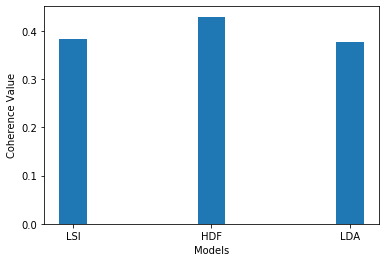

In [46]:
eveluate_bar_graph([lsi_coherence,hdp_coherence,lda_coherence],["LSI","HDF","LDA"])

In [47]:
lsi_coherence

0.3832864362858897